In [46]:
%load_ext autoreload
%autoreload 2
import h5py
import healpy as hp
from spectral_index import find_spec_index
import numpy as np
import matplotlib.pyplot as pl
import spectral_index_perpix as sipp
from spectral_index_perpix import extrapolate_per_pixel 
from spectral_index_perpix import spectral_index_curvature
from scipy import stats
import copy
import os


#extrapolate
def extrapolate_in_nu(map_in, nu_base, nu_desired, beta):
    map_in_copy = map_in.copy()
    return map_in_copy*(nu_desired/nu_base)**(-beta)

def extrapolate_in_nu_perpixel(map_in, nu_base, nu_desired, beta):
    map_in_copy = map_in.copy()
    extrapolated_map = np.zeros_like(map_in_copy)
    for i in range(len(extrapolated_map)):
        extrapolated_map[i] = map_in_copy[i]*(nu_desired/nu_base)**(-beta[i]) 
    return extrapolated_map

def apply_hp_mask(map_in, threshold):
    map_out = map_in.copy()
    for i in range(map_in.shape[0]):
        if map_in[i] == threshold:
            map_out[i] = hp.UNSEEN
    return map_out

#they both do the same thing
def apply_hp_mask(map_in, threshold):
    mask = np.where(map_in == threshold)
    map_out = map_in.copy()
    for i in range(len(mask[0])):
        map_out[mask[0][i]] = hp.UNSEEN
        
    return map_out


def replace_area_with_number(map_to_be_replaced, value, map_replacer):
#takes in a map, finds the masked regions and replaces it with the value found in another map
    map_to_be_replaced_copy = map_to_be_replaced.copy()
    map_replacer_copy = map_replacer.copy()
    regions_to_replace = np.where(map_to_be_replaced_copy == value)
    ctr = 0 
    for i in range(len(regions_to_replace[0])):
        map_to_be_replaced_copy[regions_to_replace[0][i]] = map_replacer_copy[regions_to_replace[0][i]]
        ctr += 1
    print(str(ctr) + ' points were replaced ')

    return map_to_be_replaced_copy


def copy_masked_area_from_one_to_another(map_with_masks, map_to_be_masked):
#takes in a map, finds the masked regions and replaces it with the value found in another map
    map_with_masks_copy = map_with_masks.copy()
    map_to_be_masked_copy = map_to_be_masked.copy()
    regions_to_replace = np.where(map_with_masks_copy == hp.UNSEEN)
    for i in range(len(regions_to_replace[0])):
        map_to_be_masked_copy[regions_to_replace[0][i]] = hp.UNSEEN

    return map_to_be_masked_copy


def mean_unmasked_region(map_with_masks, mask_value):
    masked_regions = np.where(map_with_masks == mask_value)
    #make a copy
    map_with_masks_copy = map_with_masks.copy()
    try:
        n = 0
        for i in range(len(masked_regions[0])):
            map_with_masks_copy[masked_regions[0][i]] = 0
            n += 1
        return np.sum(map_with_masks_copy)/float(len(map_with_masks_copy ) - n)
    except:
        print('There are no masked regions')
        return np.mean(map_with_masks_copy)
            
            

def convert_ell_to_degrees(ell):
    return float(360)/float(2*ell)

def convert_ell_to_rads(ell):
    return float(2*np.pi)/float(2*ell)



The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


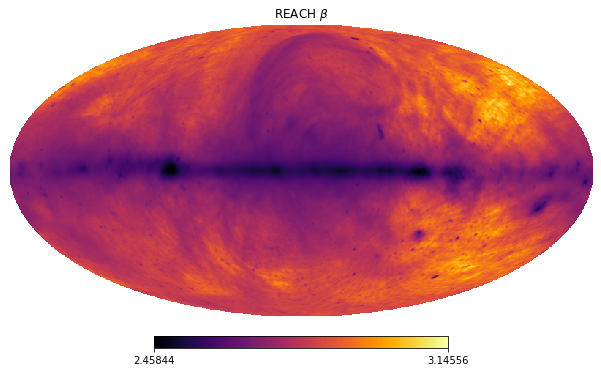

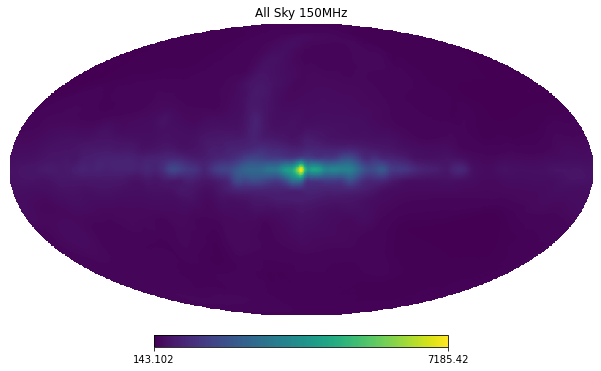

In [47]:
#original noise realization
path = '/Users/michael/Research/REACH/scale_factor_Nreg/Debug_stuff/Spectral_Index_Map/B_map.npz'

beta_map = np.load(path)
B_f408_t230_REACH = beta_map['B_map']
hp.visufunc.mollview(B_f408_t230_REACH , cmap = 'inferno', title = r'REACH $\beta$')


allsky_150MHz = np.load('allsky_150MHz.npy')
hp.visufunc.mollview(allsky_150MHz , title = "All Sky 150MHz")



Load all the maps

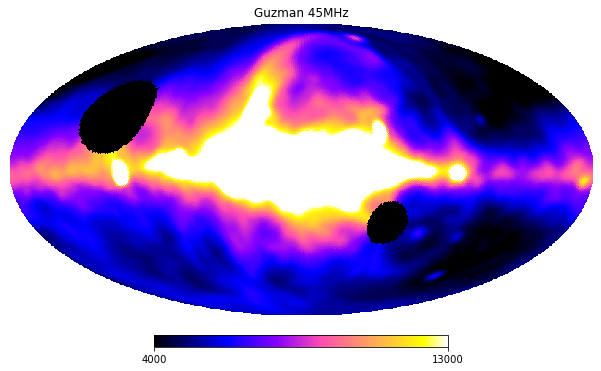

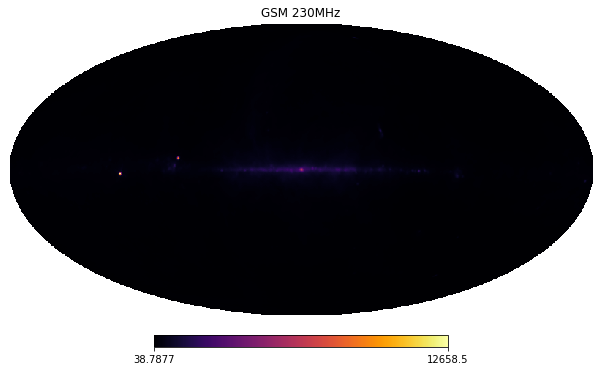

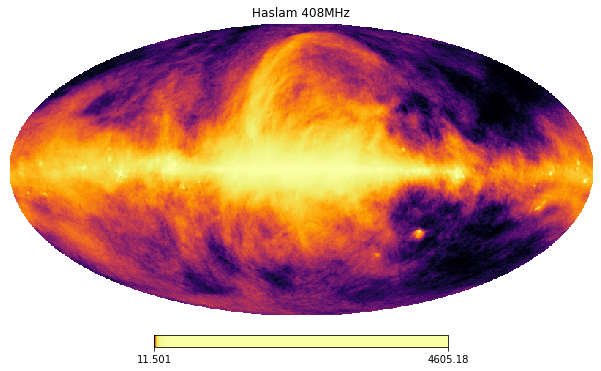

In [69]:
path2maps = '/Users/michael/Research/REACH/scale_factor_Nreg/Sky_maps/'

Guzman_45 = np.load(os.path.join(path2maps, 'guzman_45.npy'))
Guzman45_nside512 = hp.pixelfunc.ud_grade(Guzman_45, 512)
GSM_230 = np.load(os.path.join(path2maps, 'base_map_230.npy'))
Haslam_408 = np.load(os.path.join(path2maps, 'HASLAM_healpix_temperature_ring.npy'))

#lets look at the maps
hp.visufunc.mollview(Guzman_45 , cmap = 'gnuplot2', title = r'Guzman 45MHz', min = 4000, max = 13000)
hp.visufunc.mollview(GSM_230 , cmap = 'inferno', title = r'GSM 230MHz')
hp.visufunc.mollview(Haslam_408 , cmap = 'inferno', title = r'Haslam 408MHz', norm = 'hist')

# 45MHz to 408MHz

/Users/michael/Research/REACH/scale_factor_Nreg/Debug_stuff/spectral_index_perpix.py:32: RuntimeWarning: invalid value encountered in log
  self.beta = np.log(np.true_divide( np.subtract(self.map1, self.Tcmb), np.subtract(self.map2 , self.Tcmb)))/float(np.log(self.map2_freq/self.map1_freq))


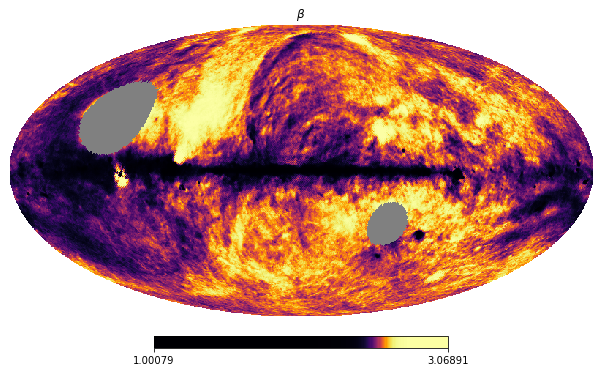

In [49]:

spec_index_calculator = sipp.SI_calculator(Guzman45_nside512, Haslam_408, 45, 408)
beta_f45_t408 = spec_index_calculator.beta
hp.visufunc.mollview(beta_f45_t408 , cmap = 'inferno', title = r'$\beta$', norm = 'hist')




That doesnt match the paper version at all. Let us smooth it over using healpy.sphtfunc.smoothing

/Users/michael/miniconda3/lib/python3.8/site-packages/healpy/sphtfunc.py:822: UserWarning: Sigma is 127.398325 arcmin (0.037059 rad) 
  warnings.warn(
/Users/michael/miniconda3/lib/python3.8/site-packages/healpy/sphtfunc.py:827: UserWarning: -> fwhm is 300.000129 arcmin
  warnings.warn(
/Users/michael/miniconda3/lib/python3.8/site-packages/healpy/sphtfunc.py:822: UserWarning: Sigma is 0.000000 arcmin (0.000000 rad) 
  warnings.warn(
/Users/michael/miniconda3/lib/python3.8/site-packages/healpy/sphtfunc.py:827: UserWarning: -> fwhm is 0.000000 arcmin
  warnings.warn(


maps are not the same nside


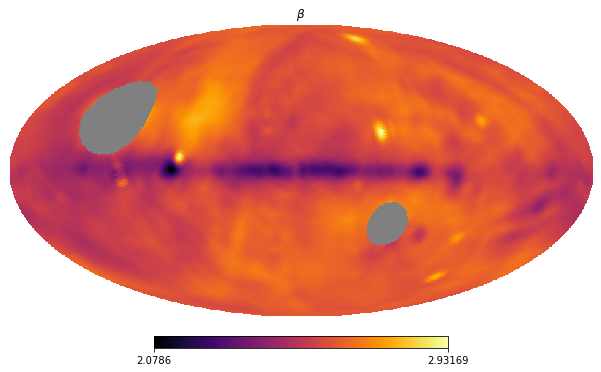

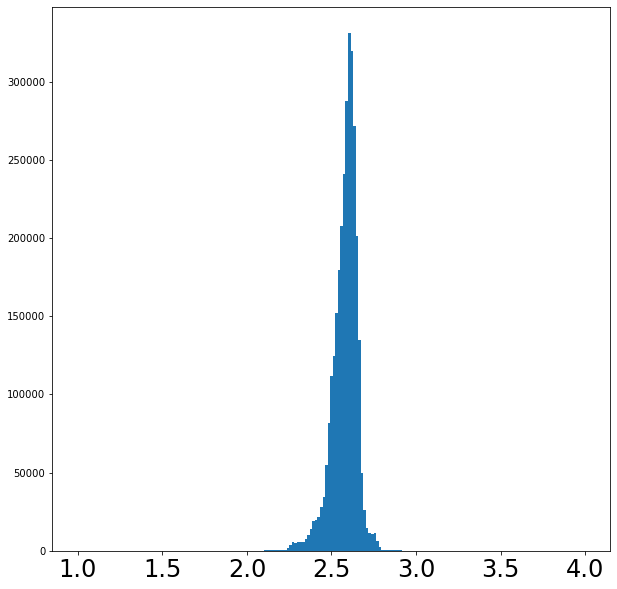

(3145728,)


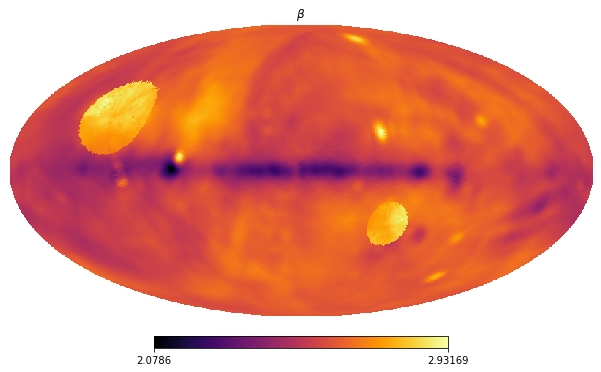

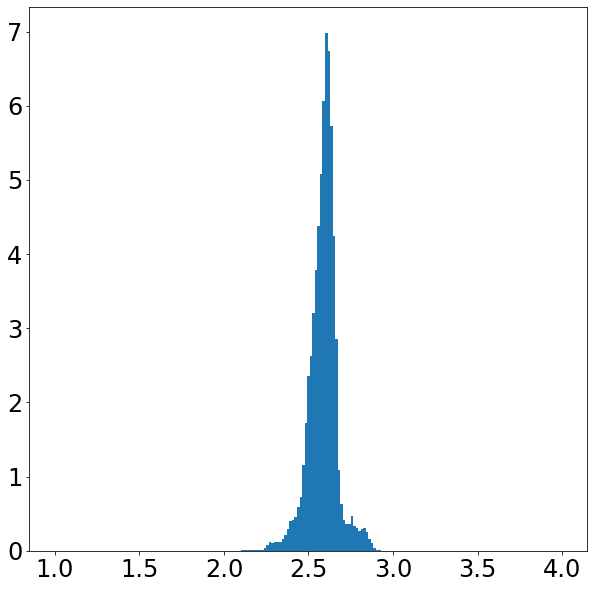

In [50]:
#smoothing over 5 degrees (0.0872665 rads)
spec_index_calculator = sipp.SI_calculator(Guzman_45, hp.sphtfunc.smoothing(Haslam_408, fwhm = 0.0872665), 45, 408)
beta_f45_t408_smoothed = spec_index_calculator.beta
hp.visufunc.mollview(beta_f45_t408_smoothed , cmap = 'inferno', title = r'$\beta$')

pl.figure(figsize = (10,10))
pl.hist(beta_f45_t408_smoothed, bins = np.linspace(1, 4, 200))
pl.xticks(fontsize = 24)
pl.show()
pl.close()


#B_f408_t230_REACH = beta_map['B_map']
beta_f45_t408_smoothed_REACHholes = copy.deepcopy(beta_f45_t408_smoothed)
print(beta_f45_t408_smoothed_REACHholes.shape)

for i in range(len(beta_f45_t408_smoothed_REACHholes)):
    if np.isnan(beta_f45_t408_smoothed[i]):
        beta_f45_t408_smoothed_REACHholes[i]  = B_f408_t230_REACH[i]
    
hp.visufunc.mollview(beta_f45_t408_smoothed_REACHholes , cmap = 'inferno', title = r'$\beta$')

pl.figure(figsize = (10,10))
pl.hist(beta_f45_t408_smoothed_REACHholes, bins = np.linspace(1, 4, 200), density = True)
pl.xticks(fontsize = 24)
pl.yticks(fontsize = 24)
pl.show()
pl.close()

#np.savez('beta_f45_t408_smoothed_REACHholes.npz', B_map = beta_f45_t408_smoothed_REACHholes)

#contrast between the real REACH SI map and the newly generated one (from 45 -> 408)
#hp.visufunc.mollview(beta_f45_t408_smoothed_REACHholes - B_f408_t230_REACH  , min = -0.5, max = 0.5, cmap = 'RdBu', title = r'$\beta$')

#what does the 230 basemap look like with this SI


Use this spectral map to extrapolate Guzman 45MHz to GSM 230MHz

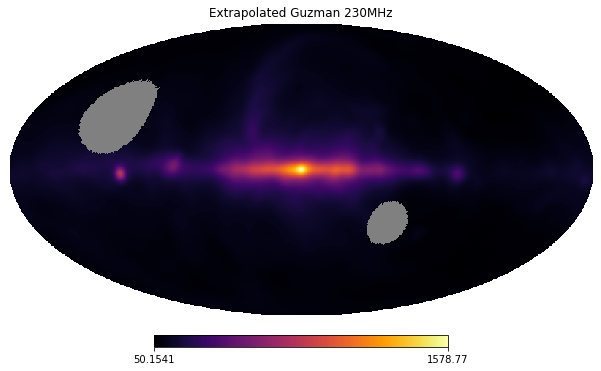

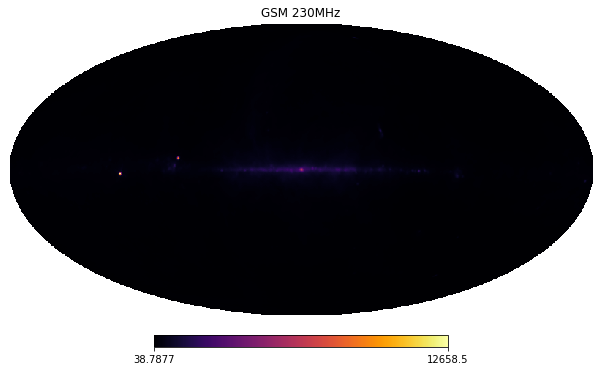

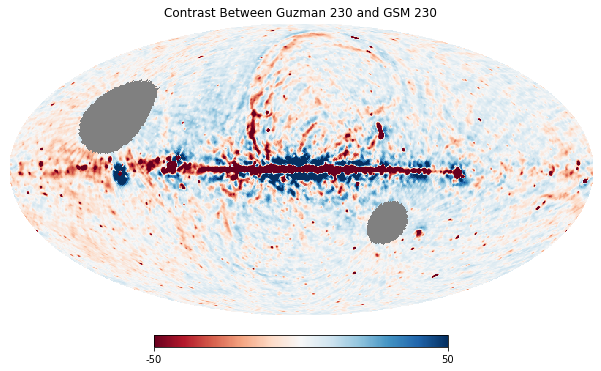

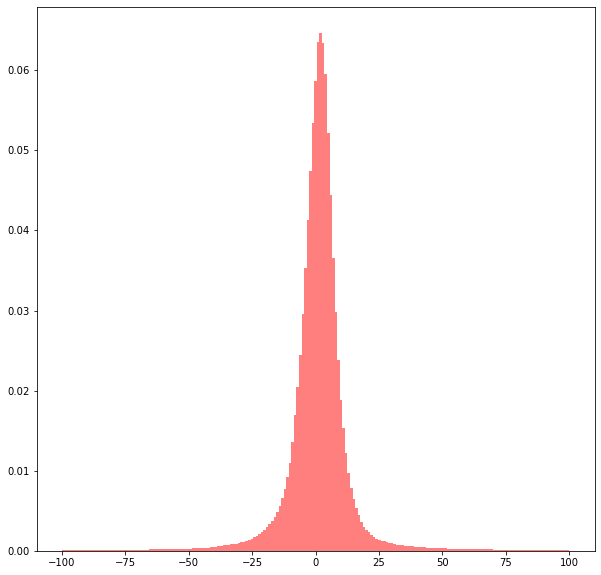

In [51]:
Guzman_230_extrapolator_smoothedBeta = extrapolate_per_pixel(Guzman45_nside512, 45, 230 , beta_f45_t408_smoothed)

#this is what the extrapolated map looks like
hp.visufunc.mollview(Guzman_230_extrapolator_smoothedBeta.extrapolated_map , cmap = 'inferno',  title = r'Extrapolated Guzman 230MHz' )

#hp.visufunc.mollview(Haslam_408 , cmap = 'inferno',  norm = 'hist', title = 'Haslam 408MHz' )
hp.visufunc.mollview(GSM_230 , cmap = 'inferno',  title = 'GSM 230MHz' )

contrast_masked = np.subtract(Guzman_230_extrapolator_smoothedBeta.extrapolated_map ,GSM_230)
hp.visufunc.mollview(contrast_masked,  cmap = 'RdBu', min = -50, max = 50,  title = 'Contrast Between Guzman 230 and GSM 230' )



#the histogram of the noise should hopefully be mean 0
contrast_masked_values = contrast_masked.copy()[contrast_masked.copy() > hp.UNSEEN]
pl.figure(figsize = (10,10))
p, bins, n = pl.hist(contrast_masked_values , np.linspace(-100,100, 200), color = 'red', alpha = 0.5, density = 'True')
pl.show()
pl.close()

#print(np.mean(contrast_masked_values), np.min(contrast_masked_values), np.max(contrast_masked_values))
#print(np.mean(contrast_masked), np.max(contrast_masked), np.min(contrast_masked))


1582.3823 50.15023
mean of this map  138.06892  for a difference of  3.4332796995993533


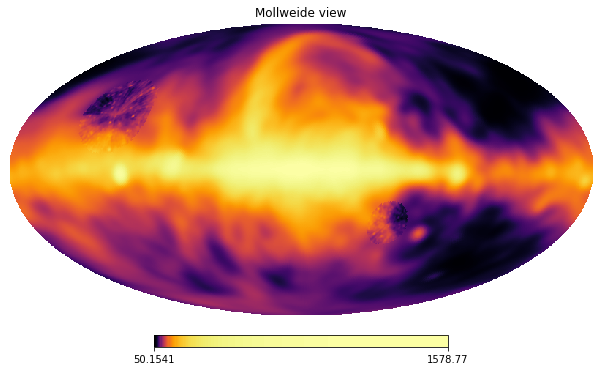

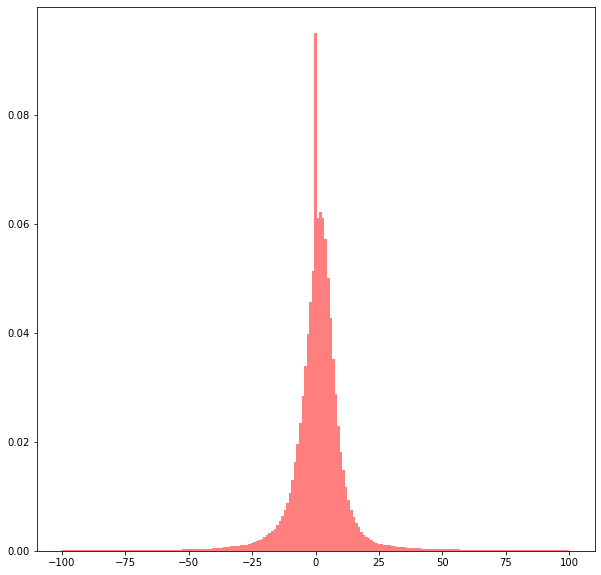

-3.433242947380555


In [53]:
#Finally beautifully Gaussian
#Replace the masked regions with our best guess of the sky which is the GSM 230
#Due to a bug, the masked regions got turned to Nan
Guzman_230_smoothedBeta = Guzman_230_extrapolator_smoothedBeta.extrapolated_map

#this is just a rename
Guzman_230_smoothedBeta_GSM230Replaced = Guzman_230_smoothedBeta.copy()
for i in range(len(Guzman_230_smoothedBeta)):
    if np.isnan(Guzman_230_smoothedBeta_GSM230Replaced[i]):
        Guzman_230_smoothedBeta_GSM230Replaced[i] = GSM_230[i]
        
print(np.max(Guzman_230_smoothedBeta_GSM230Replaced), np.min(Guzman_230_smoothedBeta_GSM230Replaced))
        
print('mean of this map ' , np.mean(Guzman_230_smoothedBeta_GSM230Replaced), ' for a difference of ', np.mean(GSM_230) - np.mean(np.mean(Guzman_230_smoothedBeta_GSM230Replaced)))    
np.save('Guzman_230_smoothedBeta_GSM230Replaced.npy', Guzman_230_smoothedBeta_GSM230Replaced)

hp.visufunc.mollview(Guzman_230_smoothedBeta_GSM230Replaced, cmap = 'inferno',  norm = 'hist')

#double check that we didn't screw up the stats or the map
check = True
if check:
    diff = np.subtract(Guzman_230_smoothedBeta_GSM230Replaced.copy(), GSM_230)
    pl.figure(figsize = (10,10))
    diff_values = diff[diff != 0]
    p, bins, n = pl.hist(diff_values , np.linspace(-100,100, 200), color = 'red', alpha = 0.5, density = 'True')
    pl.show()
    pl.close()

    print(np.mean(diff_values))






# Results

In [25]:
!open /Volumes/Tubster/REACH/Guzman230/RealisticSI/Scafac_25percentile_Guzman230_2SI_GSMholes_60minObs_Memo/analysis/total_comparison.pdf

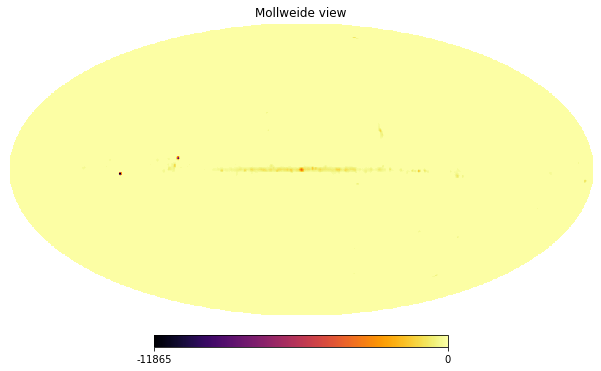

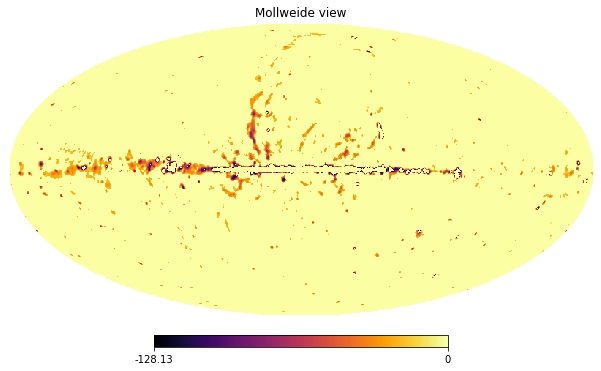

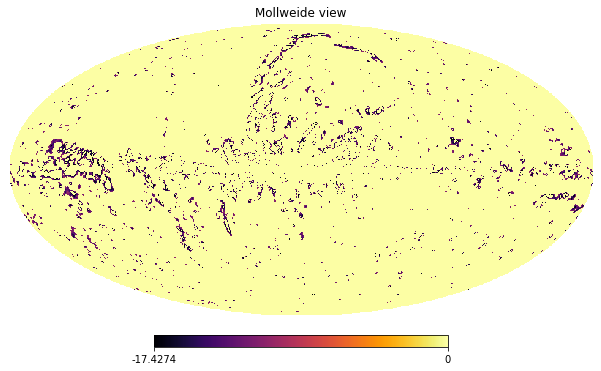

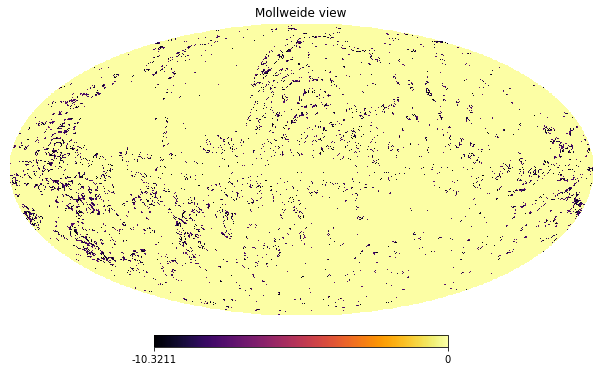

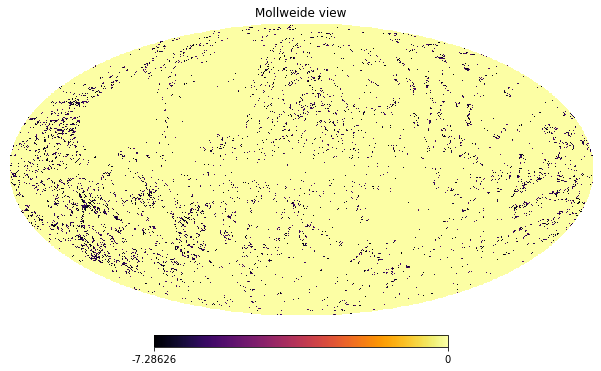

...

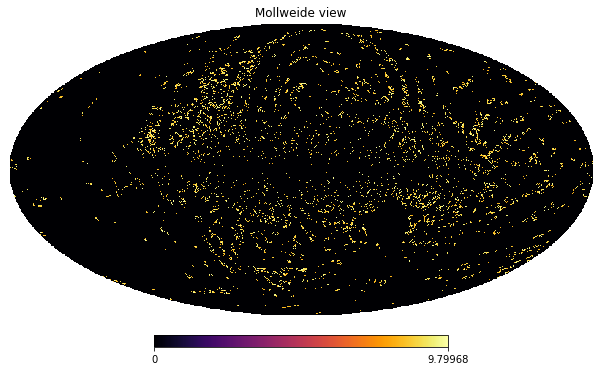

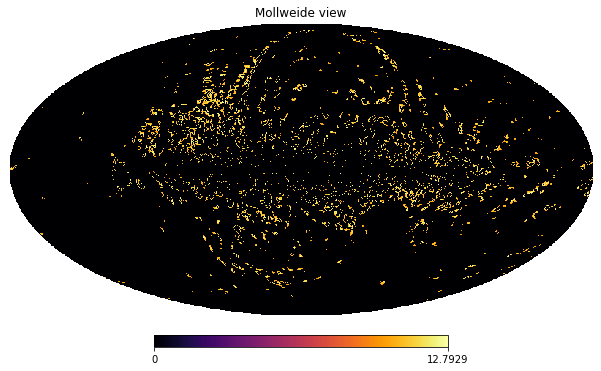

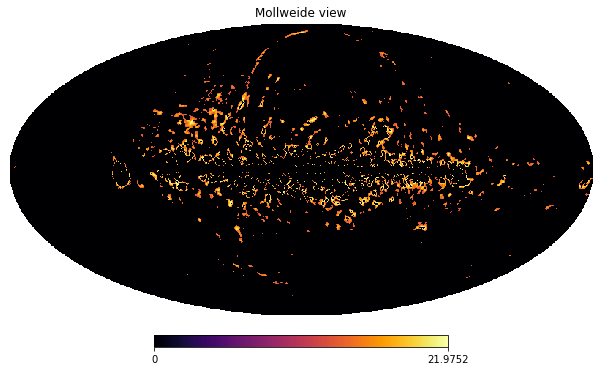

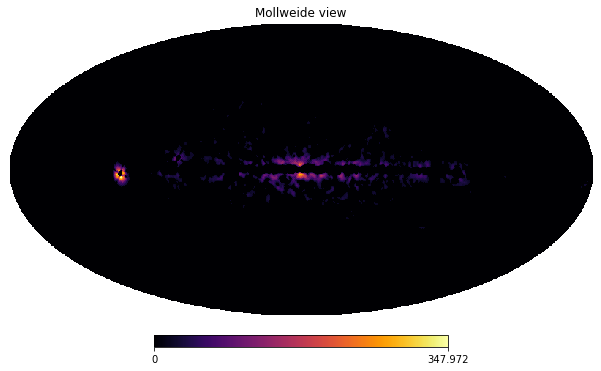

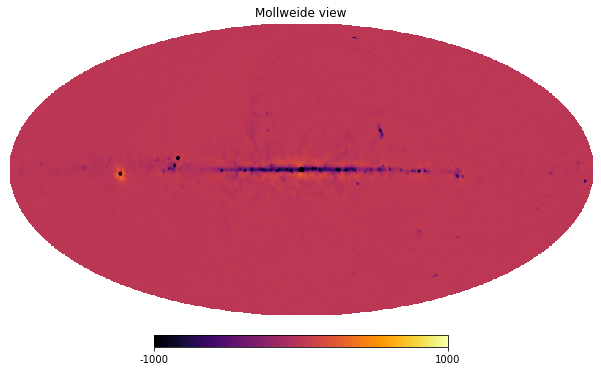

In [20]:
noise = np.load('/Volumes/Tubster/REACH/Guzman230/RealisticSI/Scafac_25percentile_Guzman230_2SI_GSMholes_60minObs_Memo/Noise_ContrastBtwn_SMOOTHEDGuz230_GSM230_holesGSM.npy')

input_map = noise
N_reg_scafac = 25

masks = np.zeros((len(input_map) , N_reg_scafac))
temp_divider = np.zeros((N_reg_scafac + 1))
#print('the temperature dividers are ' , len(temp_divider), ' long ')

temp_divider[0] = np.min(input_map)
temp_divider[-1] = np.max(input_map)

#print('The max of the map is ' , temp_divider[-1] )
percentiles = np.linspace(1, 97, int(N_reg_scafac -1 ) )
for i in range(N_reg_scafac - 1):
    #print('dividing percentiles are ' , percentiles[i])
    temp_divider[i + 1] = np.percentile(input_map ,  percentiles[i])

for i in range(N_reg_scafac - 1):
    #print('values must be between ' ,temp_divider[i] , ' percentile and ' , temp_divider[i+1] )
    masks[:,i] = np.where((input_map >= temp_divider[i]) & (input_map < temp_divider[i+1]), 1,0 )


masks[:, -1] = np.where((input_map >= temp_divider[-2]) & (input_map < temp_divider[-1]), 1,0 )

#take a look to see if everything went well
for i in range(N_reg_scafac):
    hp.visufunc.mollview(np.multiply(input_map, masks[:,i]) , cmap = 'inferno')
    pl.show()
    pl.close()
    
    
hp.visufunc.mollview(noise_map, cmap = 'inferno', min = -1000, max = 1000)


## 25 Regions 


Dim No.       Mean        Sigma
  1  0.270009891525214E+001 +/-   0.110481911310887E-004
  2  0.785121548810185E+000 +/-   0.737969935537114E-002
  3  0.883801973770007E+000 +/-   0.101167618486670E-001
  4  0.155978945215937E+001 +/-   0.206132831916236E-001
  5  0.205081096963478E-003 +/-   0.109472975223657E-003
  6  0.133570556896057E-001 +/-   0.787528229011509E-002
  7  0.876175333798603E+000 +/-   0.320354903797171E-001
  8  0.169522040942131E+001 +/-   0.435128335448635E-001
  9  0.110552435963988E+001 +/-   0.355908588073600E-001
 10  0.138341504000025E+001 +/-   0.305713421770727E-001
 11  0.151078631765493E+001 +/-   0.423645090218508E-001
 12  0.961558040966364E+000 +/-   0.173384936063816E-001
 13  0.163524473081280E+001 +/-   0.507538167567489E-001
 14  0.166784671128073E+001 +/-   0.531101456170853E-001
 15  0.888574799632775E+000 +/-   0.428856974167591E-001
 16  0.281112051897157E+000 +/-   0.255749347199382E-001
 17  0.949241404839845E+000 +/-   0.354782851685826E-001
 18  0.109641235537956E+001 +/-   0.501976412061316E-001
 19  0.198493344393626E-001 +/-   0.737765338600326E-002
 20  0.195614961064263E+001 +/-   0.332621340990977E-001
 21  0.247635333772236E-001 +/-   0.760274742148800E-002
 22  0.141855253748242E+001 +/-   0.660960234771662E-001
 23  0.181548570292677E+001 +/-   0.604225287540134E-001
 24  0.106719580278321E-001 +/-   0.414464694914903E-002
 25  0.142147325632391E+001 +/-   0.193115319617286E-001
 26  0.928806806242239E+000 +/-   0.748474633505949E-002
 27  0.516267751209072E+002 +/-   0.178711758001878E+001
 28  0.143444224552114E+002 +/-   0.938326354430731E+000
 29  0.342458144331047E+000 +/-   0.507255152140769E-001
 30  0.248455606000787E-001 +/-   0.119446275556031E-003

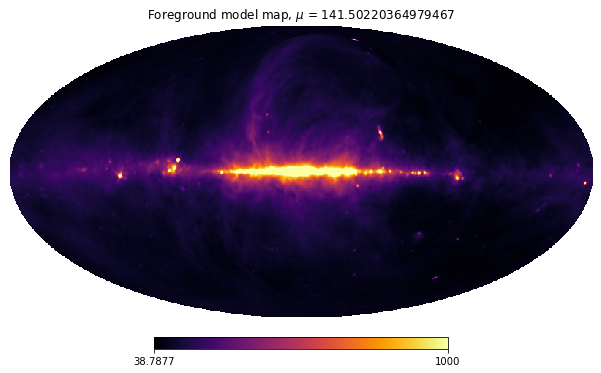

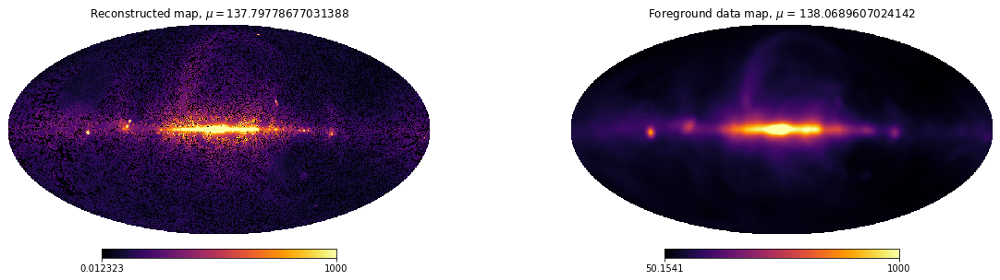

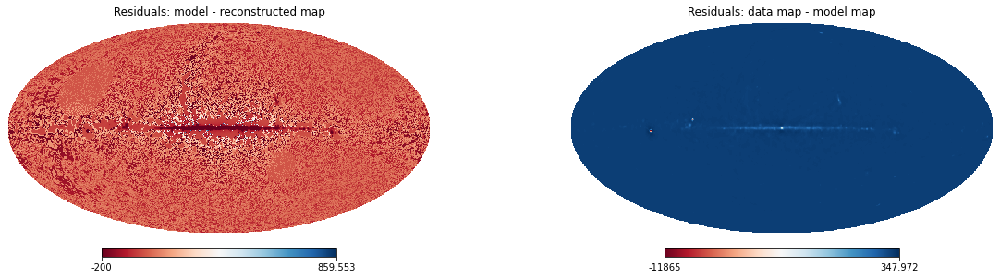

In [22]:
#Reconstruct the maps
from reconstruct_map import Reconstructor
#path to errors and maps 

GSM_230_wNoise = GSM_230 + noise
amp_scale_factors = (0.785121548810185,0.883801973770007, 0.1559789452159e1, 0.205081096963478e-3, 0.1335705568960e-1,0.8761753337986e0, 0.169522040942e1,0.110552435963e1,0.138341504000e1,0.1510786317654e1,0.9615580409663e0,0.1635244730e1,0.166784671128e1,0.888574799632e0, 0.2811120518971e0,0.949241404839e0,0.10964123553e1,0.1984933443e-1,0.195614961064e1,0.2476353337722e-1,0.141855253748e1,0.181548570292e1,0.1067195802e-1,0.1421473256323e1,0.928806806e0) 

#make a reconstructor object
posterior_map = Reconstructor(amp_scale_factors, GSM_230, masks, return_residuals = True)
posterior_map.reconstruct_map()
reconstructed_map = posterior_map.reconstructed_map
residuals  = posterior_map.residuals

mean_original = np.mean(GSM_230)
mean_reconstructed = np.mean(reconstructed_map)
mean_GSM_230_wNoise = np.mean(GSM_230_wNoise)
vmax = 1000
#hp.visufunc.mollview(reconstructed_map , max = vmax, cmap = 'inferno', title = r'Reconstructed map, $\mu = $' + str(mean_reconstructed))
hp.visufunc.mollview(GSM_230 , max = vmax, cmap = 'inferno', title = r'Foreground model map, $\mu$ = ' + str(mean_original))
#hp.visufunc.mollview(allsky_150MHz_wNoise ,max = vmax, cmap = 'inferno', title = r'Foreground data map, $\mu$ = ' + str(mean_allsky_150MHz_wNoise))
#hp.visufunc.mollview(np.subtract(allsky_150MHz_wNoise, reconstructed_map) , cmap = 'RdBu', title = r' Residuals: noisy map - reconstructed map ')
#hp.visufunc.mollview(np.subtract(allsky_150MHz_wNoise, allsky_150MHz) , cmap = 'RdBu', title = r' Residuals: noisy map - noise free map ')



fig, (ax1, ax2) = pl.subplots(ncols=2, figsize = (20,5))
pl.axes(ax1)
hp.visufunc.mollview(reconstructed_map , hold = True, max = vmax, cmap = 'inferno', title = r'Reconstructed map, $\mu = $' + str(mean_reconstructed))
pl.axes(ax2)
hp.visufunc.mollview(GSM_230_wNoise ,hold = True, max = vmax, cmap = 'inferno', title = r'Foreground data map, $\mu$ = ' + str(mean_GSM_230_wNoise))
pl.show()
pl.close()

fig, (ax1, ax2) = pl.subplots(ncols=2, figsize = (20,5))
pl.axes(ax1)
hp.visufunc.mollview(np.subtract(reconstructed_map,GSM_230) , min = -200, hold = True, cmap = 'RdBu', title = r' Residuals: model - reconstructed map ')
pl.axes(ax2)
hp.visufunc.mollview(np.subtract(GSM_230_wNoise, GSM_230) ,hold = True, cmap = 'RdBu', title = r' Residuals: data map - model map ')
pl.show()
pl.close()

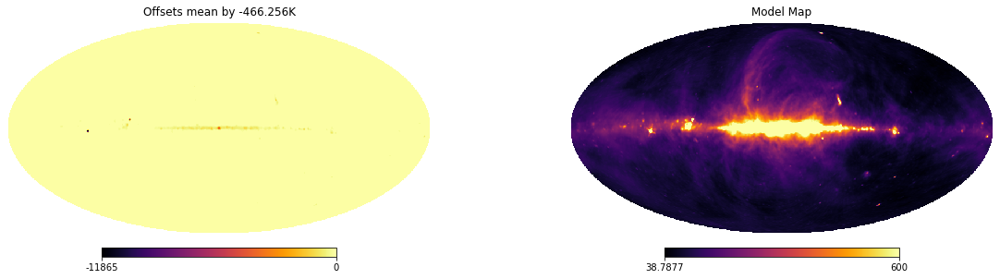

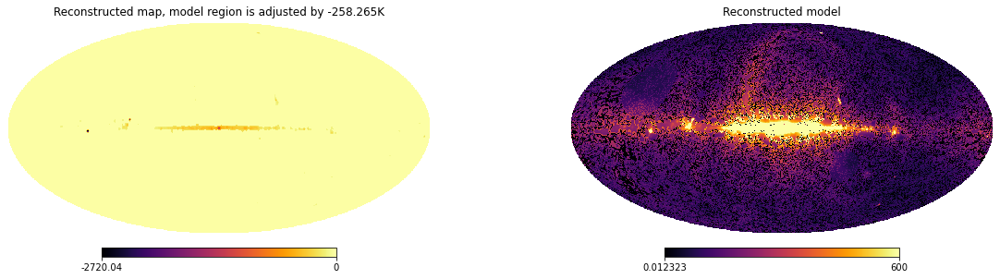

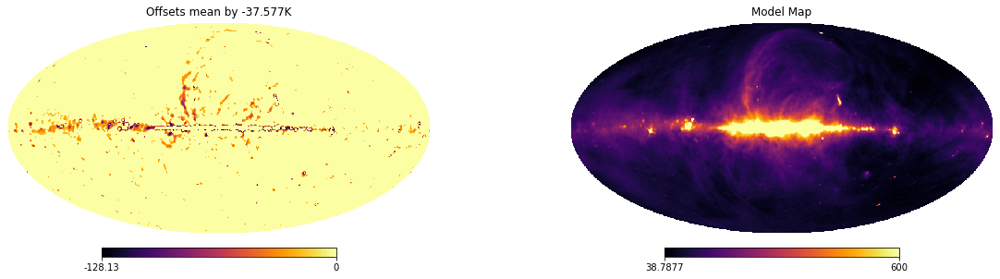

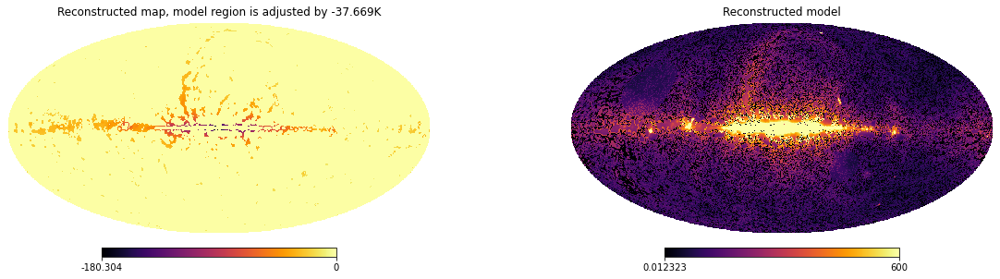

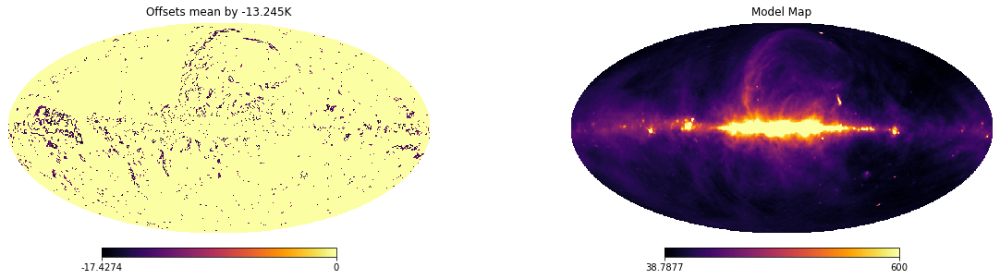

...

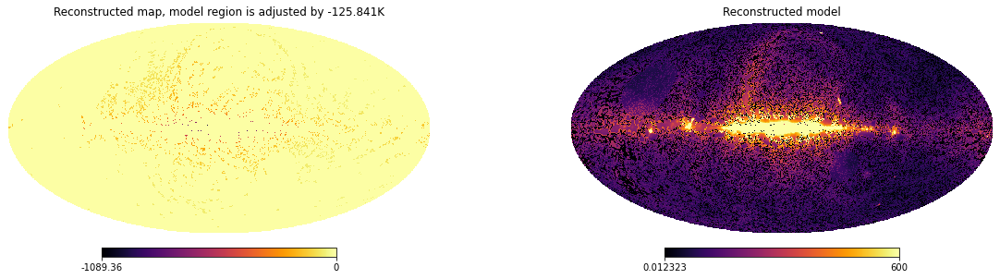

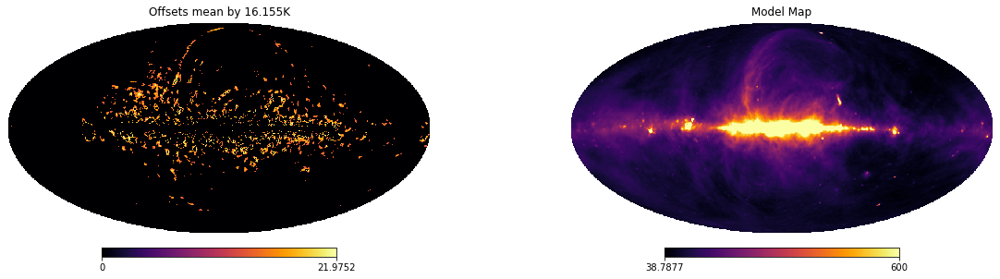

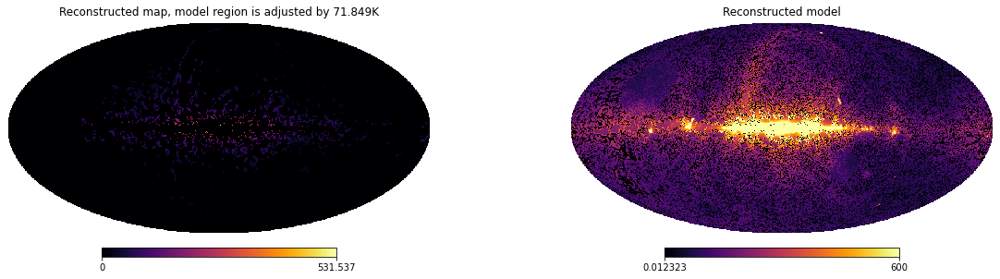

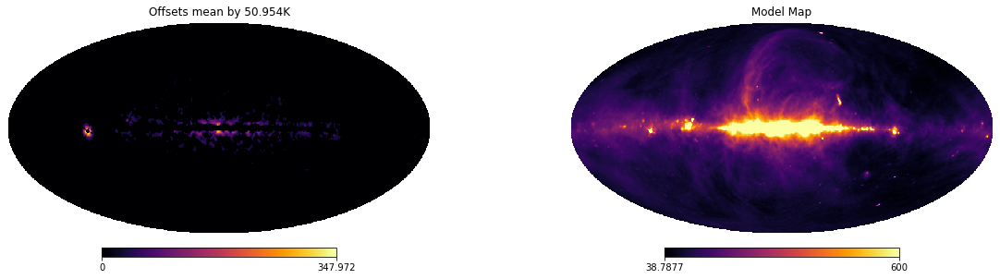

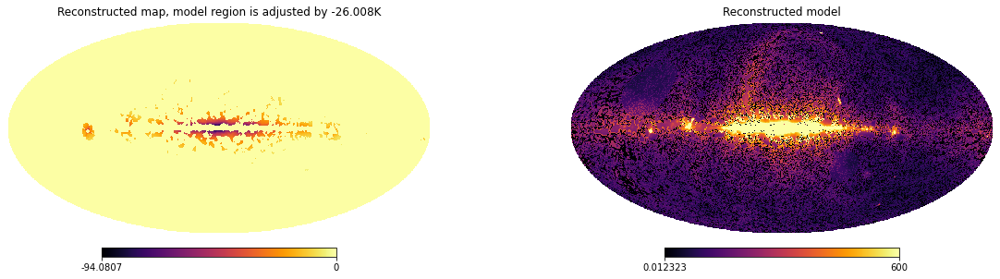

In [23]:
for i in range(masks.shape[1]):
    unmasked_region_errors = np.multiply(np.subtract(GSM_230_wNoise, GSM_230), masks[:,i])
    unmasked_region_originalmap = np.multiply(GSM_230, masks[:,i])
    unmasked_region_datamap = np.multiply(GSM_230_wNoise, masks[:,i])
    unmasked_regions_reconstructed = np.multiply(reconstructed_map, masks[:,i])
    
    mean_nonzero_region_errors = np.mean(unmasked_region_errors[unmasked_region_errors != 0] )
    mean_nonzero_region_originalmap = np.mean(unmasked_region_originalmap[unmasked_region_originalmap != 0] )
    mean_nonzero_region_datamap = np.mean(unmasked_region_datamap[unmasked_region_datamap != 0] )
    mean_nonzero_reigon_reconstructed = np.mean(unmasked_regions_reconstructed[unmasked_regions_reconstructed != 0 ])
    
    #print('mean of unmasked regions in : (errors) , (original map), (data map) , (reconstruced_map)')
    #print('                                 ' , np.round(mean_nonzero_region_errors,3), np.round(mean_nonzero_region_originalmap,3), np.round(mean_nonzero_region_datamap,3), np.round(mean_nonzero_reigon_reconstructed, 3) )
    fig, (ax1, ax2) = pl.subplots(ncols=2, figsize = (20,5))
    pl.axes(ax1)
    hp.visufunc.mollview(np.multiply(np.subtract(GSM_230_wNoise, GSM_230), masks[:,i]), title = r'Offsets mean by ' + str(np.round(mean_nonzero_region_errors,3)) +'K', hold = True , cmap = 'inferno')
    pl.axes(ax2)
    #hp.visufunc.mollview(np.subtract(allsky_150MHz_wNoise, allsky_150MHz), title = 'Entire Error map ', hold = True , cmap = 'inferno')
    hp.visufunc.mollview(GSM_230, max = 600, title = 'Model Map', hold = True , cmap = 'inferno')
    pl.show()
    pl.close()
    fig, (ax1, ax2) = pl.subplots(ncols=2, figsize = (20,5))
    pl.axes(ax1)
    hp.visufunc.mollview(unmasked_regions_reconstructed - unmasked_region_originalmap, title = r'Reconstructed map, model region is adjusted by ' +str(np.round(mean_nonzero_reigon_reconstructed -mean_nonzero_region_originalmap ,3)) +'K' , hold = True , cmap = 'inferno')
    pl.axes(ax2)
    hp.visufunc.mollview(reconstructed_map, title = 'Reconstructed model', max = 600, hold = True , cmap = 'inferno')
    pl.show()
    pl.close()
    
    

## That didn't work. Re-arrange the errormap to scale factor amplitudes


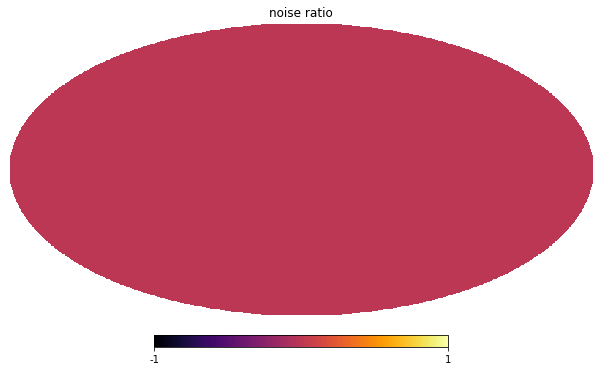

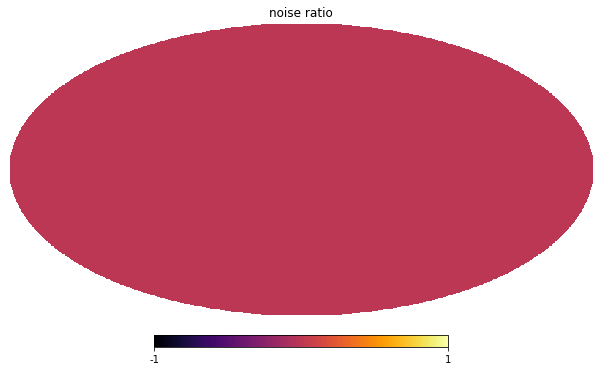

In [60]:
data_map = Guzman_230_smoothedBeta_GSM230Replaced
noise_map = data_map - GSM_230

hp.visufunc.mollview(noise_map -noise , title = 'noise ratio',   cmap = 'inferno')

dat = np.load('/users/michael/Guzman_230_smoothedBeta_from_smoothed45and230_GSM230Replaced.npy') 
hp.visufunc.mollview(dat - GSM_230 - noise , title = 'noise ratio',   cmap = 'inferno')

dividing percentiles are  1.0
dividing percentiles are  8.538461538461538
dividing percentiles are  16.076923076923077
dividing percentiles are  23.615384615384613
dividing percentiles are  31.153846153846153
dividing percentiles are  38.69230769230769
dividing percentiles are  46.230769230769226
dividing percentiles are  53.76923076923077
dividing percentiles are  61.30769230769231
dividing percentiles are  68.84615384615384
dividing percentiles are  76.38461538461539
dividing percentiles are  83.92307692307692
dividing percentiles are  91.46153846153845
dividing percentiles are  99.0


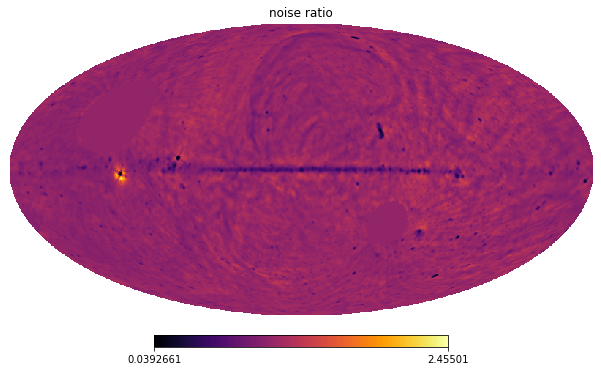

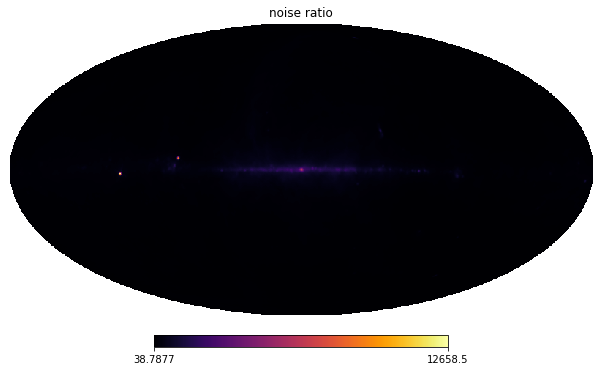

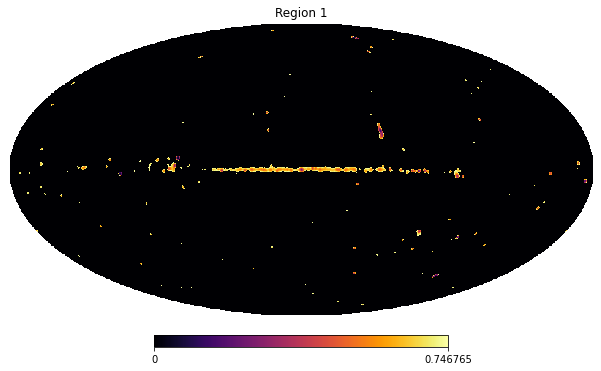

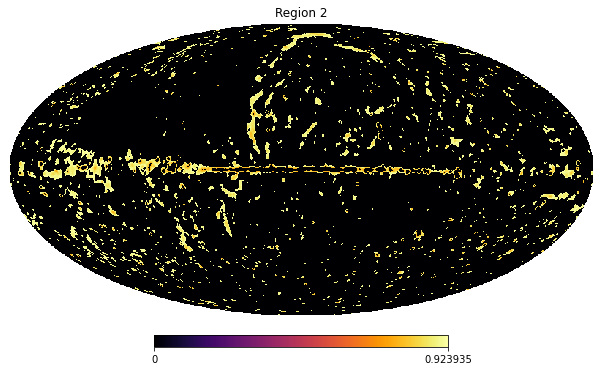

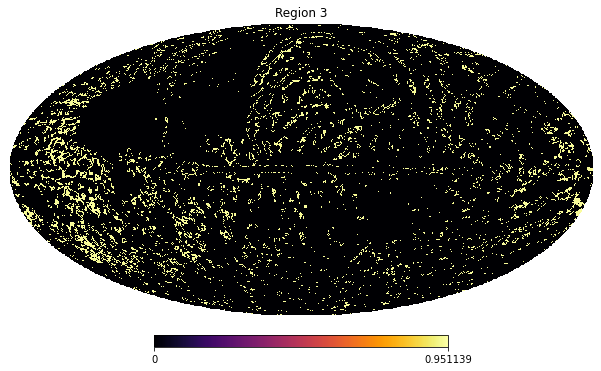

...

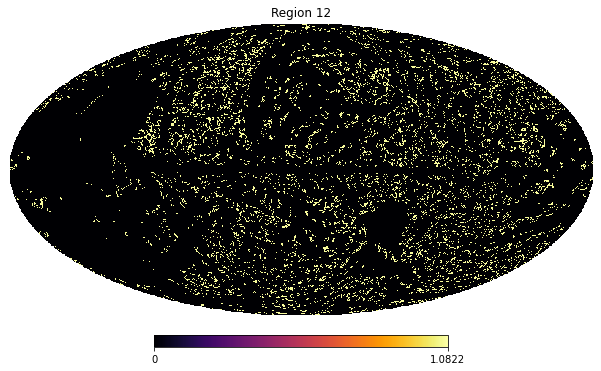

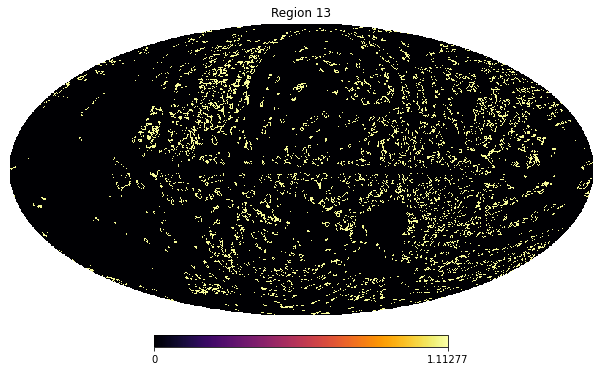

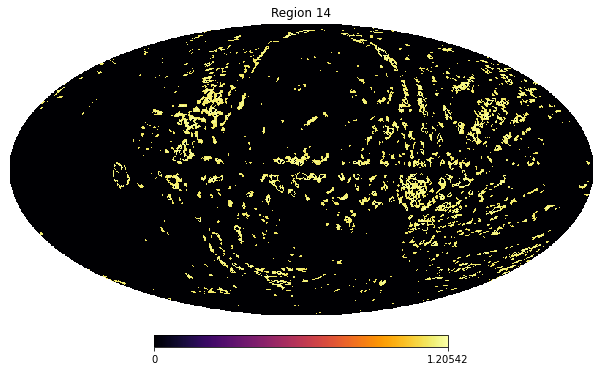

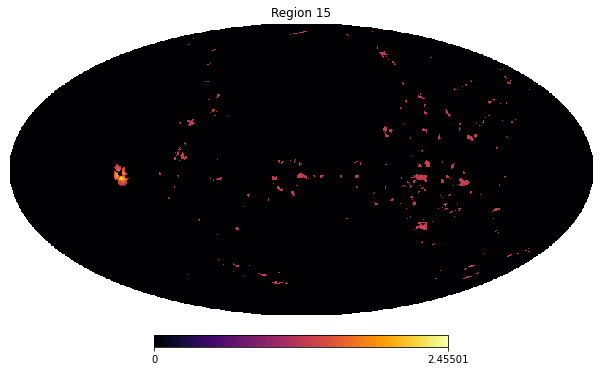

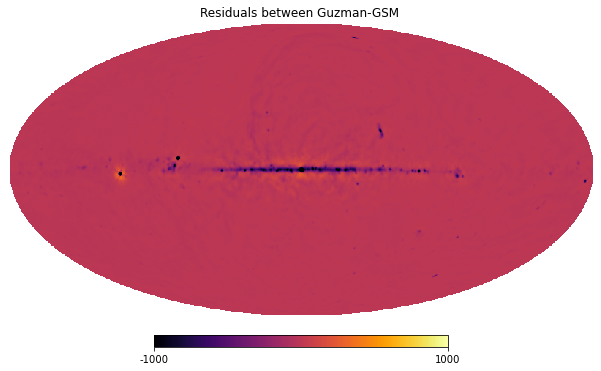

In [152]:
GSM_230_wNoise = GSM_230 + noise

ratio = np.true_divide(GSM_230_wNoise, GSM_230)

hp.visufunc.mollview(ratio, title = 'noise ratio',   cmap = 'inferno')

hp.visufunc.mollview(GSM_230, title = 'noise ratio',   cmap = 'inferno')



input_map = ratio
N_reg_scafac = 15

masks = np.zeros((len(input_map) , N_reg_scafac))
temp_divider = np.zeros((N_reg_scafac + 1))
#print('the ratio dividers are ' , len(temp_divider), ' long ')

temp_divider[0] = np.min(input_map)
temp_divider[-1] = np.max(input_map)

#print('The max of the map is ' , temp_divider[-1] )
percentiles = np.linspace(1, 99, int(N_reg_scafac -1 ) )
for i in range(N_reg_scafac - 1):
    print('dividing percentiles are ' , percentiles[i])
    temp_divider[i + 1] = np.percentile(input_map ,  percentiles[i])

for i in range(N_reg_scafac - 1):
    #print('values must be between ' ,temp_divider[i] , ' percentile and ' , temp_divider[i+1] )
    masks[:,i] = np.where((input_map >= temp_divider[i]) & (input_map < temp_divider[i+1]), 1,0 )


masks[:, -1] = np.where((input_map >= temp_divider[-2]) & (input_map < temp_divider[-1]), 1,0 )

#take a look to see if everything went well
for i in range(N_reg_scafac):
    hp.visufunc.mollview(np.multiply(input_map, masks[:,i]) , title = 'Region ' + str(i+ 1),  cmap = 'inferno')
    pl.show()
    pl.close()
    
    
hp.visufunc.mollview(noise_map, cmap = 'inferno', title = 'Residuals between Guzman-GSM ', min = -1000, max = 1000)

#np.save('AmplitudePertubations_For_SMOOTHEDGuz230_GSM230_holesGSM.npy', ratio)



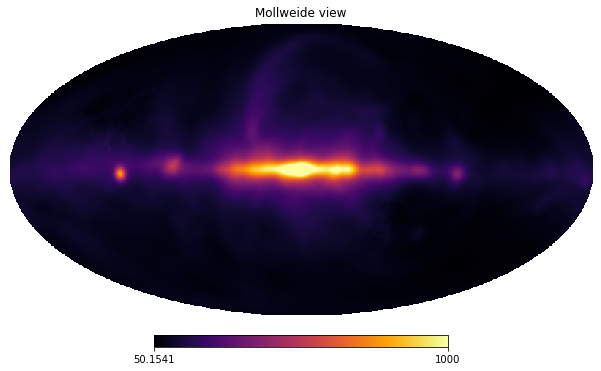

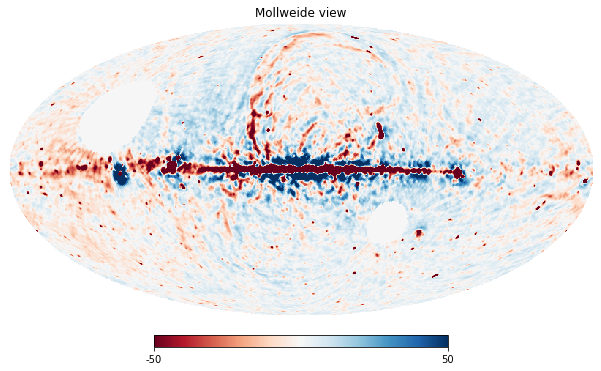

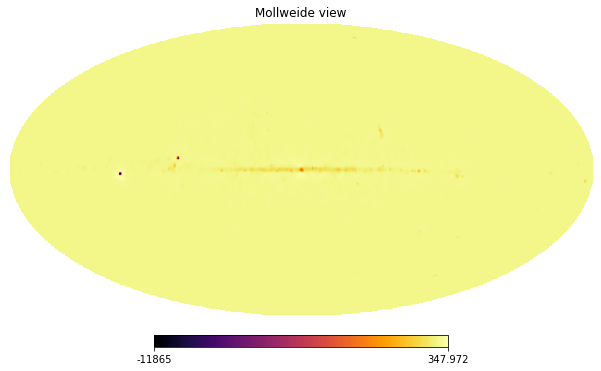

In [42]:
#lets make sure the observation data is correct
observation_data = np.load('/users/michael/Downloads/Guzman_230_smoothedBeta_from_smoothed45and230_GSM230Replaced.npy')
hp.visufunc.mollview(observation_data, cmap = 'inferno',  max = 1000)
hp.visufunc.mollview(observation_data - GSM_230, cmap = 'RdBu', min = -50, max = 50)
hp.visufunc.mollview(noise, cmap = 'inferno')



# Results from using amplitude pertubations as prior map

In [154]:
!open /Volumes/Tubster/REACH/Guzman230/RealisticSI/Scafac_15percentile_AmplitudePertubationsPriorMap_Guzman230_2SI_GSMholes_60minObs_Memo/analysis/total_comparison.pdf

In [ ]:
log(Z)       =   0.150024480467993E+003 +/-   0.125489580707403E+001

Dim No.       Mean        Sigma
  1  0.270003173279332E+001 +/-   0.685587507918339E-005
  2  0.660300312355168E+000 +/-   0.357073371225085E-002
  3  0.647024191296907E+000 +/-   0.642037759775381E-002
  4  0.146609749289550E+001 +/-   0.247179197556359E-001
  5  0.127737634153173E+001 +/-   0.246142593525874E-001
  6  0.193390674193469E+000 +/-   0.166857734484393E-001
  7  0.116290453413127E+001 +/-   0.255479248380996E-001
  8  0.952586895739574E+000 +/-   0.620890096873582E-002
  9  0.176509063193181E-001 +/-   0.610074498091061E-002
 10  0.222050421576073E+001 +/-   0.326711993870572E-001
 11  0.152650201265985E-001 +/-   0.706128401067177E-002
 12  0.283189805857264E+001 +/-   0.586466559409041E-001
 13  0.711752972052977E+000 +/-   0.373137766602648E-001
 14  0.210322426150502E-002 +/-   0.194561374346706E-002
 15  0.173516008533896E+001 +/-   0.226532301383382E-001
 16  0.948443828864210E+000 +/-   0.252961378302239E-001
 17  0.134480268479856E+003 +/-   0.108790433409667E+002
 18  0.873356182774686E+001 +/-   0.150930958865970E+001
 19  0.177400829587366E-001 +/-   0.700736017889241E-002
 20  0.248977454340983E-001 +/-   0.463774359147771E-003

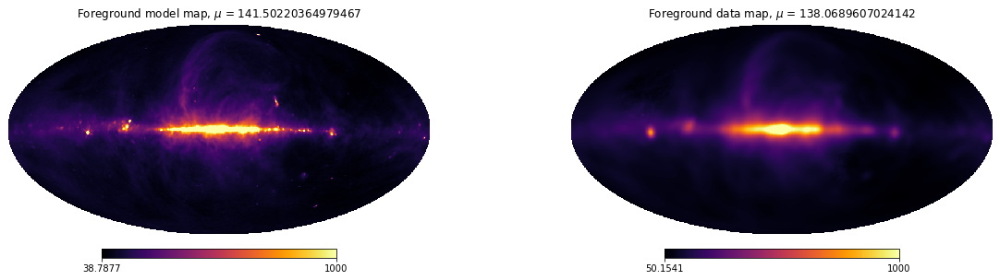

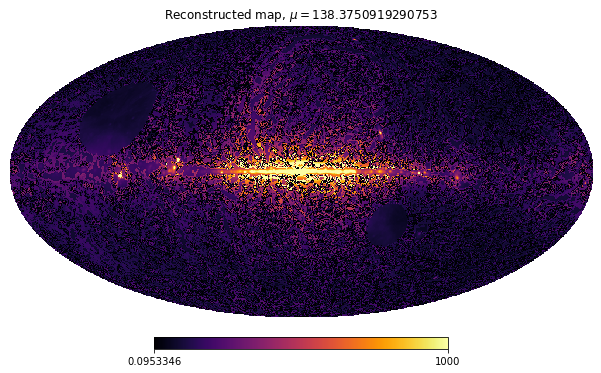

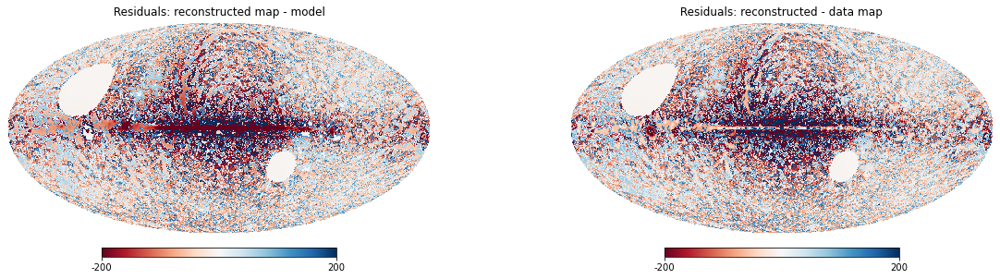

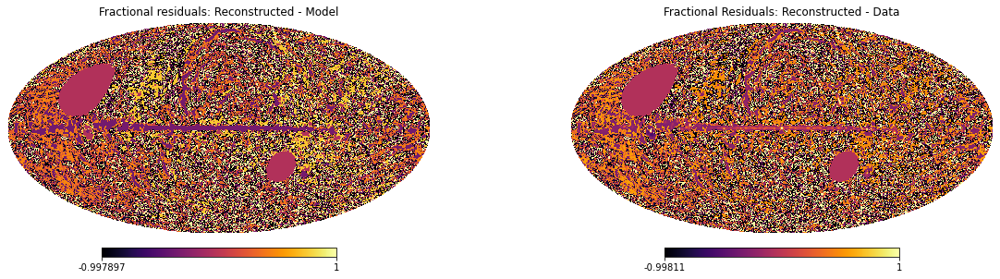

In [150]:
#lets make sure the observation data is correct
observation_data = np.load('/users/michael/Downloads/Guzman_230_smoothedBeta_from_smoothed45and230_GSM230Replaced.npy')
#hp.visufunc.mollview(observation_data, cmap = 'inferno', title = 'Data map',   max = 1000)
#hp.visufunc.mollview(observation_data - GSM_230, cmap = 'RdBu', title = 'Saturated Errors' , min = -50, max = 50)
#hp.visufunc.mollview(noise, cmap = 'inferno', title = 'errors')


GSM_230_wNoise = GSM_230 + noise
amp_scale_factors = (0.660300312355168,0.64702419129690, 0.146609749289e1, 0.1277376341531e1, 0.19339067419346,0.11629045341e1, 0.9525868957395,0.1765090631931e-1,0.2220504215760e1,0.152650201265985e-1,0.28318980585726e1,0.71175297205297,0.21032242615050e-2,0.17351600853389e1,0.94844382886421) 

#make a reconstructor object
posterior_map = Reconstructor(amp_scale_factors, GSM_230, masks, return_residuals = True)
posterior_map.reconstruct_map_notfromscratch()
reconstructed_map = posterior_map.reconstructed_map_
residuals  = posterior_map.residuals_

mean_original = np.mean(GSM_230)
mean_reconstructed = np.mean(reconstructed_map)
mean_GSM_230_wNoise = np.mean(GSM_230_wNoise)
vmax = 1000


fig, (ax1, ax2) = pl.subplots(ncols=2, figsize = (20,5))
pl.axes(ax1)
hp.visufunc.mollview(GSM_230 , hold = True, max = vmax, cmap = 'inferno', title = r'Foreground model map, $\mu$ = ' + str(mean_original))
pl.axes(ax2)
hp.visufunc.mollview(GSM_230_wNoise ,hold = True, max = vmax, cmap = 'inferno', title = r'Foreground data map, $\mu$ = ' + str(mean_GSM_230_wNoise))
pl.show()
pl.close()


hp.visufunc.mollview(reconstructed_map , xsize = 1000,  max = vmax, cmap = 'inferno', title = r'Reconstructed map, $\mu = $' + str(mean_reconstructed))


fig, (ax1, ax2) = pl.subplots(ncols=2, figsize = (20,5))
pl.axes(ax1)
hp.visufunc.mollview(np.subtract(reconstructed_map, GSM_230) , min = -200, max = 200, hold = True, cmap = 'RdBu', title = r' Residuals: reconstructed map - model ')
pl.axes(ax2)
hp.visufunc.mollview(np.subtract(reconstructed_map, GSM_230_wNoise) ,min = -200, max = 200, hold = True, cmap = 'RdBu', title = r' Residuals: reconstructed - data map ')
pl.show()
pl.close()


fig, (ax1, ax2) = pl.subplots(ncols=2, figsize = (20,5))
pl.axes(ax1)
hp.visufunc.mollview(np.true_divide(reconstructed_map-GSM_230, GSM_230)  , max =1,  hold = True,  cmap = 'inferno', title = r'Fractional residuals: Reconstructed - Model')
pl.axes(ax2)
hp.visufunc.mollview( np.true_divide(reconstructed_map- observation_data  , observation_data  ) ,  hold = True, max = 1, cmap = 'inferno', title = r'Fractional Residuals: Reconstructed - Data')
pl.show()
pl.close()

#the residuals are **starting** to look noise-like, and I would wager that if we went to > 15regions, that is
#exactly what they would look like

# Linear model

the temperature dividers are  9  long 
The max of the map is  357.97879681881574
dividing percentiles are  1.0
dividing percentiles are  17.0
dividing percentiles are  33.0
dividing percentiles are  49.0
dividing percentiles are  65.0
dividing percentiles are  81.0
dividing percentiles are  97.0
the temperature dividers are  [-1.27457357e+04 -1.28226637e+02 -5.66575373e+00 -1.29447009e+00
  9.27526232e-01  3.56635064e+00  6.92125584e+00  2.19767528e+01
  3.57978797e+02]
values must be between  -12745.735669361784  percentile and  -128.22663677336595
values must be between  -128.22663677336595  percentile and  -5.665753734073503
values must be between  -5.665753734073503  percentile and  -1.2944700892196268
values must be between  -1.2944700892196268  percentile and  0.927526231935967
values must be between  0.927526231935967  percentile and  3.5663506378953893
values must be between  3.5663506378953893  percentile and  6.921255841180885
values must be between  6.921255841180885  percen

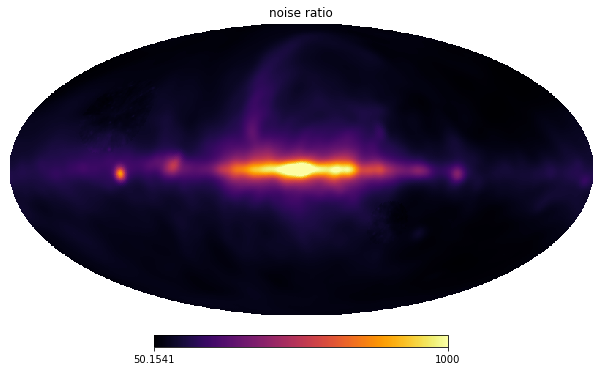

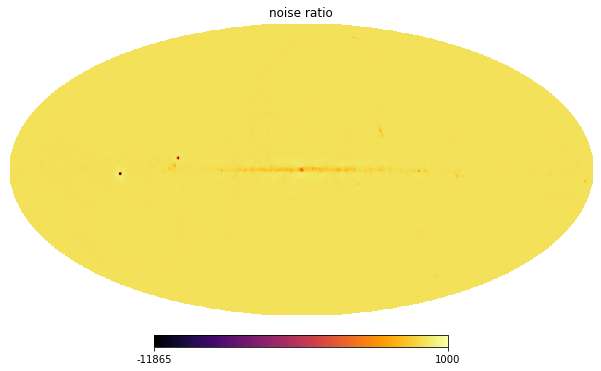

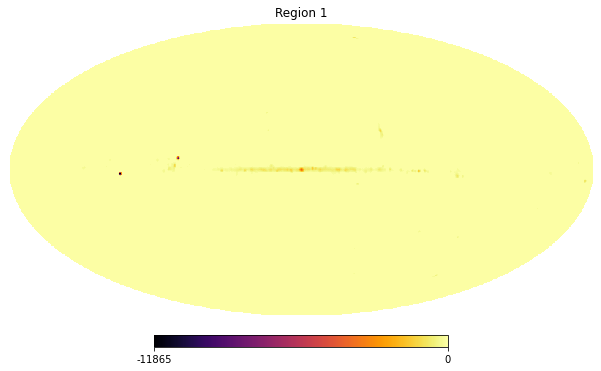

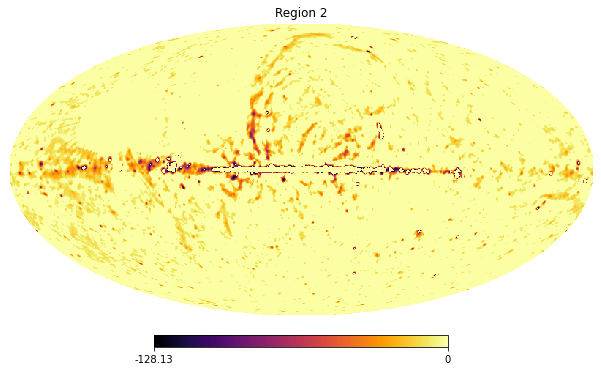

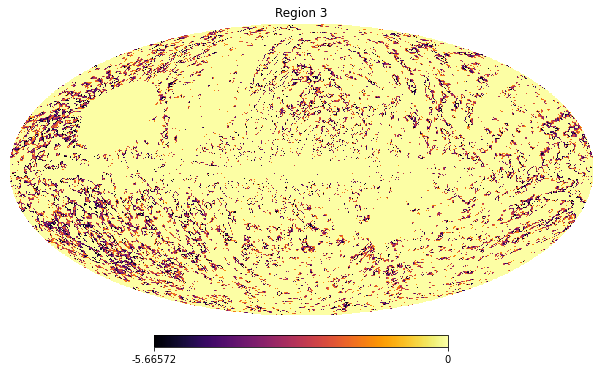

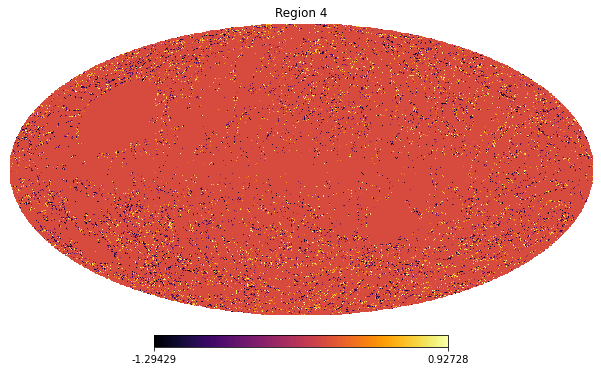

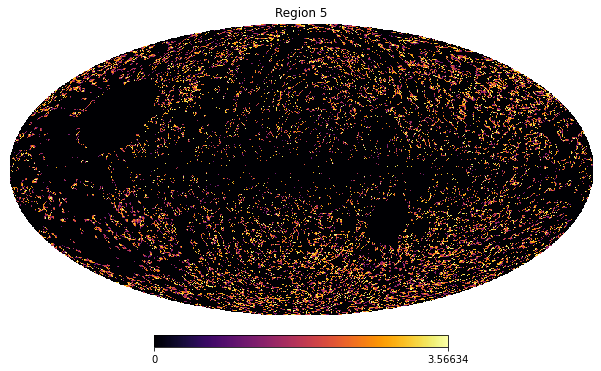

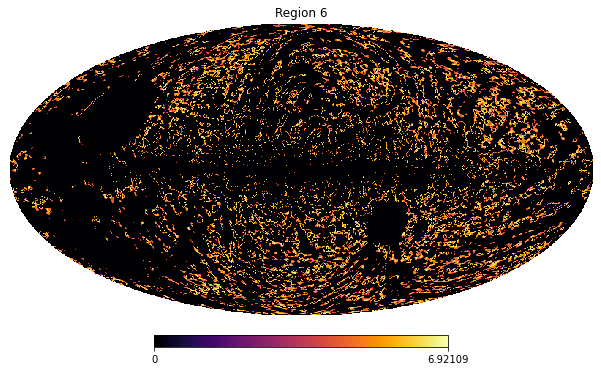

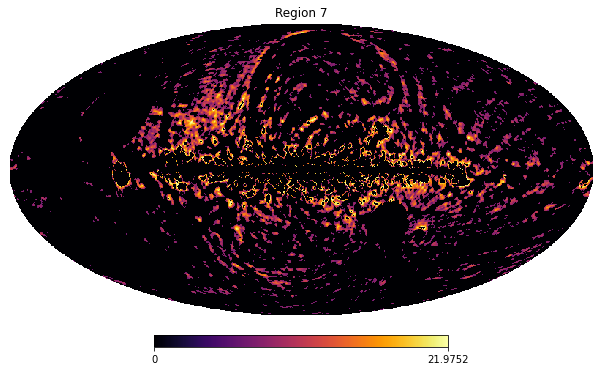

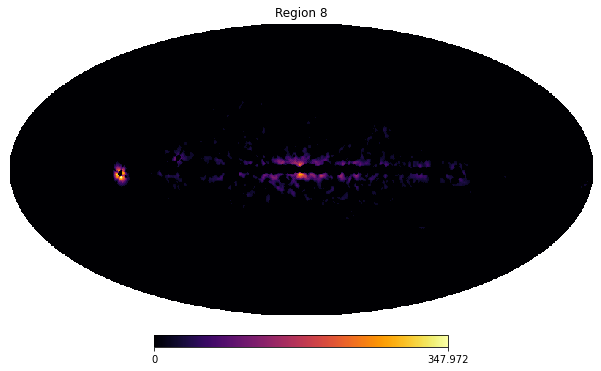

In [151]:
data_map = Guzman_230_smoothedBeta_GSM230Replaced
noise_map = data_map - GSM_230



N = np.load('/users/michael/Downloads/Guzman_230_smoothedBeta_from_smoothed45and230_GSM230Replaced.npy') 
hp.visufunc.mollview(N , max= 1000, title = 'noise ratio',   cmap = 'inferno')
hp.visufunc.mollview(N - GSM_230 , max= 1000, title = 'noise ratio',   cmap = 'inferno')

input_map = N - GSM_230
N_reg_scafac = 8
temp_divider = np.zeros((N_reg_scafac + 1))
print('the temperature dividers are ' , len(temp_divider), ' long ')

masks = np.zeros((len(input_map), N_reg_scafac))

temp_divider[0] = np.min(input_map)
temp_divider[-1] = np.max(input_map)

print('The max of the map is ' , temp_divider[-1] )
percentiles = np.linspace(1, 97, int(N_reg_scafac -1 ) )
for i in range(N_reg_scafac - 1):
    print('dividing percentiles are ' , percentiles[i])
    temp_divider[i + 1] = np.percentile(input_map ,  percentiles[i])
print('the temperature dividers are ', temp_divider )
for i in range(N_reg_scafac - 1):
    print('values must be between ' ,temp_divider[i] , ' percentile and ' , temp_divider[i+1] )
    masks[:,i] = np.where((input_map >= temp_divider[i]) & (input_map < temp_divider[i+1]), 1,0 )


masks[:, -1] = np.where((input_map >= temp_divider[-2]) & (input_map < temp_divider[-1]), 1,0 )



for i in range(N_reg_scafac):
    hp.visufunc.mollview(np.multiply(input_map, masks[:,i]) , title = 'Region ' + str(i+1),  cmap = 'inferno')
    pl.show()
    pl.close()

In [ ]:
values must be between  -12745.735669361784  percentile and  -128.22663677336595
values must be between  -128.22663677336595  percentile and  -7.577640900847617
values must be between  -7.577640900847617  percentile and  -3.123271913470173
values must be between  -3.123271913470173  percentile and  -0.5137083618714045
values must be between  -0.5137083618714045  percentile and  0.927526231935967
values must be between  0.927526231935967  percentile and  2.894543831112009
values must be between  2.894543831112009  percentile and  5.032380868058154
values must be between  5.032380868058154  percentile and  8.20102694136673
values must be between  8.20102694136673  percentile and  21.976752775259033

In [ ]:
values must be between  -12745.735669361784  percentile and  -128.22663677336595
values must be between  -128.22663677336595  percentile and  -11.394505585874468
values must be between  -11.394505585874468  percentile and  -6.185680339709642
values must be between  -6.185680339709642  percentile and  -3.6210844172283028
values must be between  -3.6210844172283028  percentile and  -1.8127843751370063
values must be between  -1.8127843751370063  percentile and  -0.3405441414551536
values must be between  -0.3405441414551536  percentile and  0.2985281122277463
values must be between  0.2985281122277463  percentile and  1.5362790133807924
values must be between  1.5362790133807924  percentile and  2.7437775415004153
values must be between  2.7437775415004153  percentile and  3.994121039900012
values must be between  3.994121039900012  percentile and  5.419186689361244
values must be between  5.419186689361244  percentile and  7.282661705002196
values must be between  7.282661705002196  percentile and  10.343381880765937
values must be between  10.343381880765937  percentile and  21.976752775259033




dividing percentiles are  1.0
dividing percentiles are  5.260869565217392
dividing percentiles are  9.521739130434783
dividing percentiles are  13.782608695652176
dividing percentiles are  18.043478260869566
dividing percentiles are  22.304347826086957
dividing percentiles are  26.56521739130435
dividing percentiles are  30.826086956521742
dividing percentiles are  35.08695652173913
dividing percentiles are  39.34782608695652
dividing percentiles are  43.608695652173914
dividing percentiles are  47.869565217391305
dividing percentiles are  52.1304347826087
dividing percentiles are  56.39130434782609
dividing percentiles are  60.652173913043484
dividing percentiles are  64.91304347826087
dividing percentiles are  69.17391304347827
dividing percentiles are  73.43478260869566
dividing percentiles are  77.69565217391305
dividing percentiles are  81.95652173913044
dividing percentiles are  86.21739130434783
dividing percentiles are  90.47826086956522
dividing percentiles are  94.73913043478

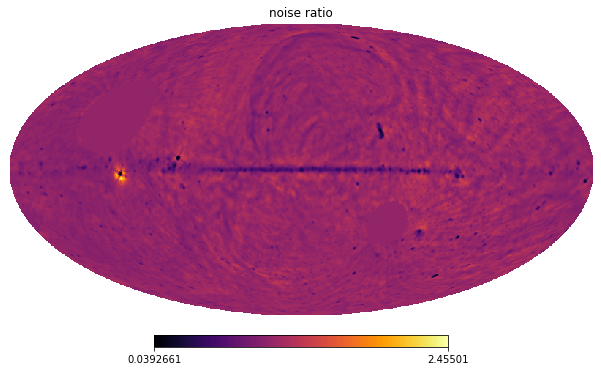

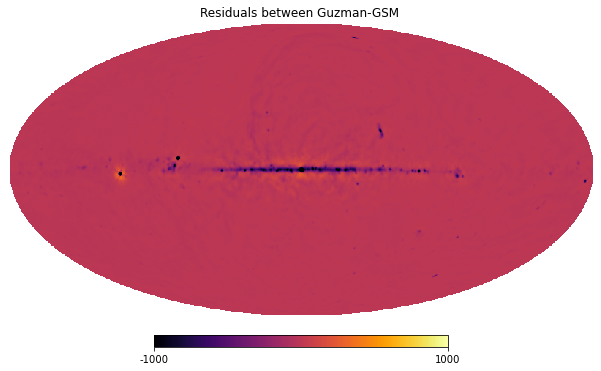

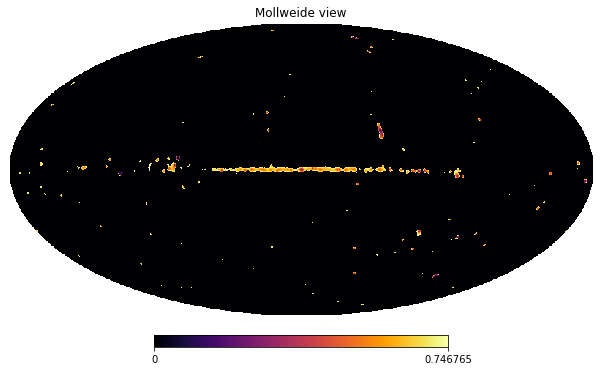

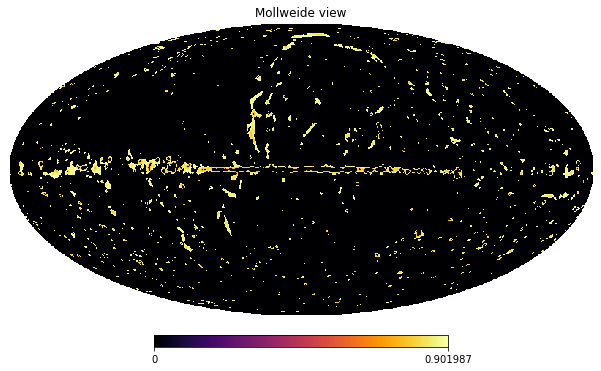

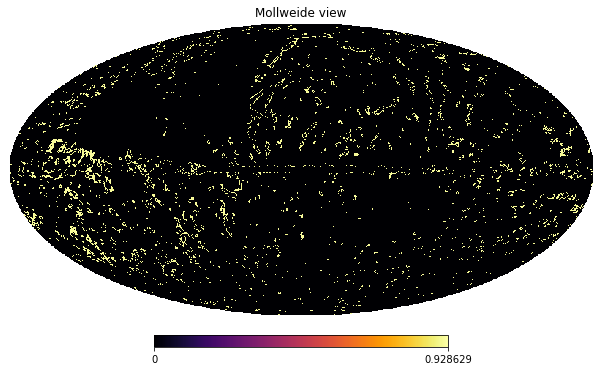

...

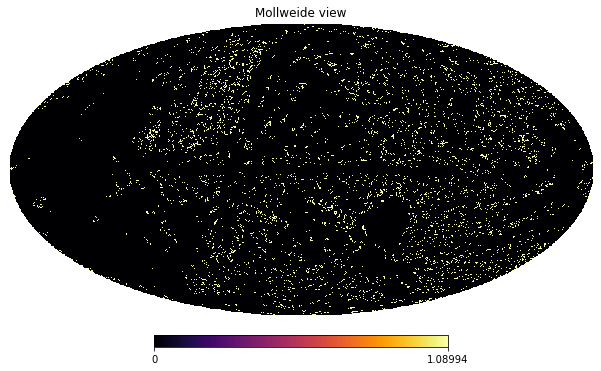

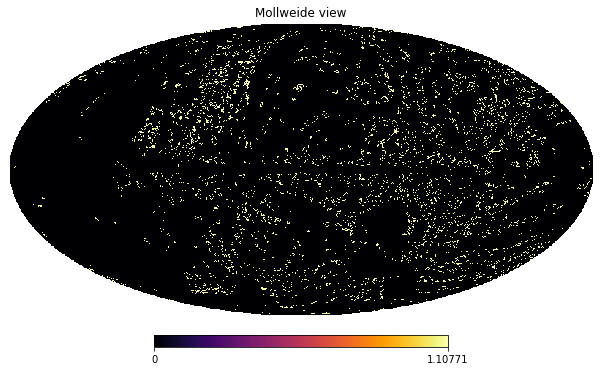

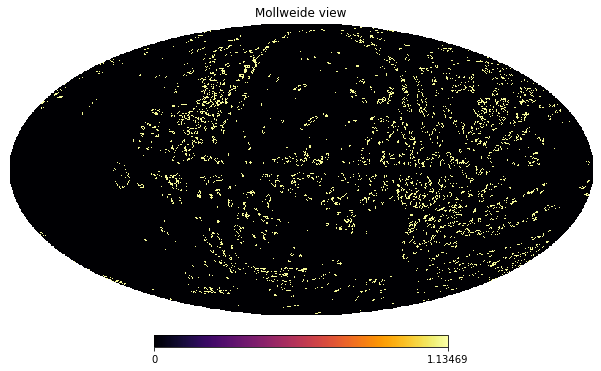

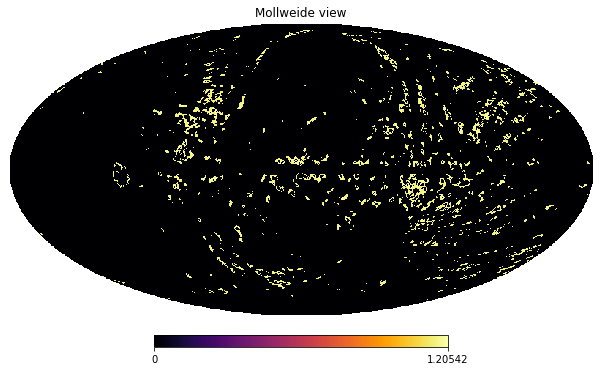

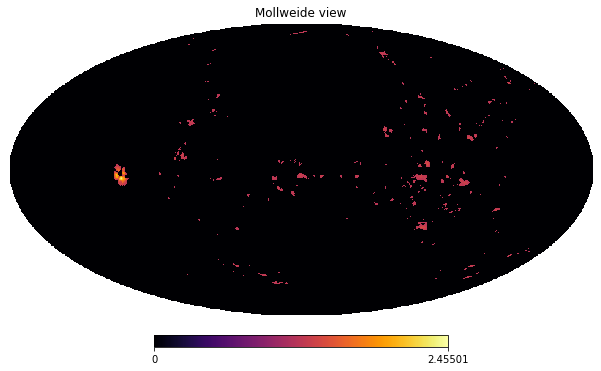

In [116]:
GSM_230_wNoise = GSM_230 + noise

ratio = np.true_divide(GSM_230_wNoise, GSM_230)

hp.visufunc.mollview(ratio, title = 'noise ratio',   cmap = 'inferno')

hp.visufunc.mollview(noise_map, cmap = 'inferno', title = 'Residuals between Guzman-GSM ', min = -1000, max = 1000)



input_map = ratio
N_reg_scafac = 25

masks = np.zeros((len(input_map) , N_reg_scafac))
temp_divider = np.zeros((N_reg_scafac + 1))
#print('the ratio dividers are ' , len(temp_divider), ' long ')

temp_divider[0] = np.min(input_map)
temp_divider[-1] = np.max(input_map)

#print('The max of the map is ' , temp_divider[-1] )
percentiles = np.linspace(1, 99, int(N_reg_scafac -1 ) )
for i in range(N_reg_scafac - 1):
    print('dividing percentiles are ' , percentiles[i])
    temp_divider[i + 1] = np.percentile(input_map ,  percentiles[i])

for i in range(N_reg_scafac - 1):
    #print('values must be between ' ,temp_divider[i] , ' percentile and ' , temp_divider[i+1] )
    masks[:,i] = np.where((input_map >= temp_divider[i]) & (input_map < temp_divider[i+1]), 1,0 )


masks[:, -1] = np.where((input_map >= temp_divider[-2]) & (input_map < temp_divider[-1]), 1,0 )

#take a look to see if everything went well
for i in range(N_reg_scafac):
    hp.visufunc.mollview(np.multiply(input_map, masks[:,i]) , cmap = 'inferno')
    pl.show()
    pl.close()
    
    


#np.save('AmplitudePertubations_For_SMOOTHEDGuz230_GSM230_holesGSM.npy', ratio)

